In [56]:
import xgboost as xgb
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import *
from imblearn.over_sampling import *

# 1. Data Exploration

In [2]:
df = pd.read_csv('data/winequality-red.csv', sep=';')

In [3]:
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


In [4]:
df.shape

(1599, 12)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599 entries, 0 to 1598
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1599 non-null   float64
 1   volatile acidity      1599 non-null   float64
 2   citric acid           1599 non-null   float64
 3   residual sugar        1599 non-null   float64
 4   chlorides             1599 non-null   float64
 5   free sulfur dioxide   1599 non-null   float64
 6   total sulfur dioxide  1599 non-null   float64
 7   density               1599 non-null   float64
 8   pH                    1599 non-null   float64
 9   sulphates             1599 non-null   float64
 10  alcohol               1599 non-null   float64
 11  quality               1599 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 150.0 KB


In [6]:
df.duplicated().sum()

240

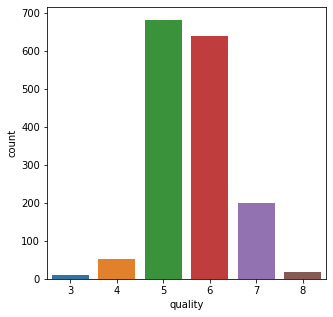

In [7]:
plt.figure(figsize=(5,5))
sns.countplot(x=df['quality'])
plt.show()

<AxesSubplot:>

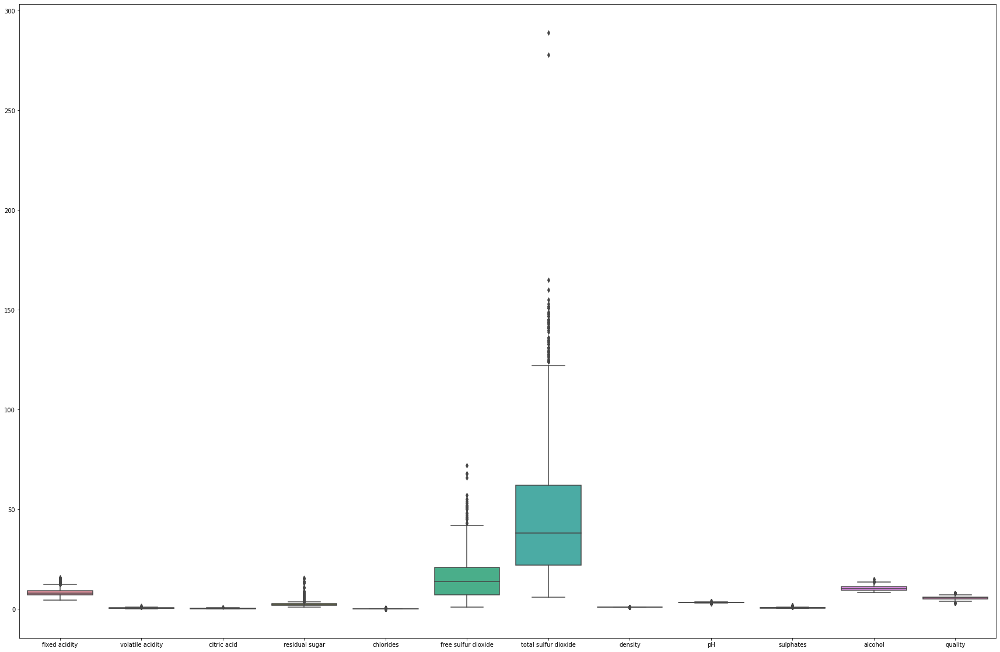

In [8]:
plt.figure(figsize=(30,20))
sns.boxplot(data=df)

## 1.1 Outlier Remove

In [9]:
q1=df.quantile(0.10)
q2=df.quantile(0.90)
qua =q2-q1

In [10]:
df=df[~((df<(q1-(1.9*qua)))|(df>(q2+(1.9*qua)))).any(axis=1)]

<AxesSubplot:>

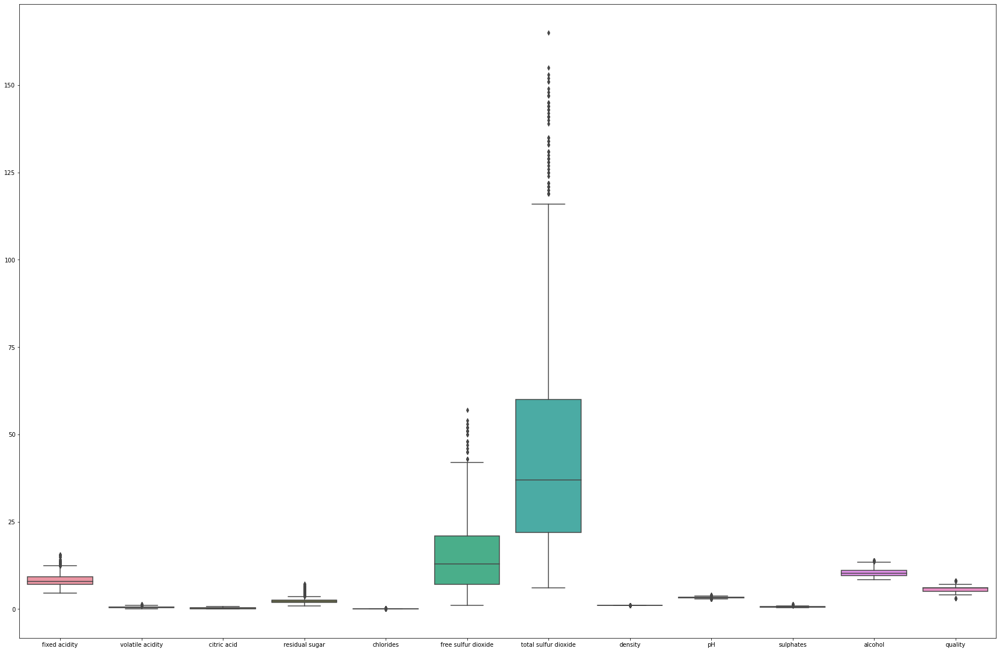

In [11]:
plt.figure(figsize=(30,20))
sns.boxplot(data=df)

Cross Validation Test

In [12]:
y = df['quality']
X = df.drop(labels=['quality'], axis=1)

In [13]:
X_trainval, X_test, y_trainval, y_test = train_test_split(X, y, test_size=0.33, random_state=96)
X_train, X_valid, y_train, y_valid = train_test_split(X_trainval, y_trainval, test_size=0.33, random_state=96)

In [14]:
learningrates = [0.5, 0.1, 0.05, 0.01, 0.005, 0.001, 0.0005, 0.0001]
max_depths = [3, 5, 10, 15, 20]
n_estimators = [10, 100, 1000, 10000] 

In [15]:
best_mse = 1
for lr in learningrates:
    for depth in max_depths:
        for estimators in n_estimators:
            print('Learning Rate : {}, Max Depth : {}, N estimators : {}'.format(lr, depth, estimators))
            xgb_model = xgb.XGBRegressor(booster='gbtree',learning_rate=lr, subsample=0.75, colsample_bytree=1, max_depth=depth, eval_metric='rmse', scale_pos_weight=6, objective='reg:squarederror', base_score=5.5, n_estimators=estimators)
            xgb_model.fit(X_train, y_train)
            predictions = xgb_model.predict(X_valid)
            mse = np.sum((y_valid - predictions)**2) / len(predictions)
            if best_mse > mse:
                print(mse)
                best_mse = mse
                best_params = {'learning_rate':lr, 'max_depths':depth, 'n_estimators':estimators}

Learning Rate : 0.5, Max Depth : 3, N estimators : 10
0.4266035782436023
Learning Rate : 0.5, Max Depth : 3, N estimators : 100
Learning Rate : 0.5, Max Depth : 3, N estimators : 1000
Learning Rate : 0.5, Max Depth : 3, N estimators : 10000
Learning Rate : 0.5, Max Depth : 5, N estimators : 10
Learning Rate : 0.5, Max Depth : 5, N estimators : 100
Learning Rate : 0.5, Max Depth : 5, N estimators : 1000
Learning Rate : 0.5, Max Depth : 5, N estimators : 10000
Learning Rate : 0.5, Max Depth : 10, N estimators : 10
Learning Rate : 0.5, Max Depth : 10, N estimators : 100
Learning Rate : 0.5, Max Depth : 10, N estimators : 1000
Learning Rate : 0.5, Max Depth : 10, N estimators : 10000
Learning Rate : 0.5, Max Depth : 15, N estimators : 10
Learning Rate : 0.5, Max Depth : 15, N estimators : 100
Learning Rate : 0.5, Max Depth : 15, N estimators : 1000
Learning Rate : 0.5, Max Depth : 15, N estimators : 10000
Learning Rate : 0.5, Max Depth : 20, N estimators : 10
Learning Rate : 0.5, Max Depth

In [16]:
print(best_mse, best_params)

0.3610063995582986 {'learning_rate': 0.005, 'max_depths': 10, 'n_estimators': 1000}


In [17]:
xgb_model = xgb.XGBRegressor(booster='gbtree',learning_rate=best_params['learning_rate'], subsample=0.75, colsample_bytree=1, max_depth=best_params['max_depths'], eval_metric='rmse', scale_pos_weight=6, objective='reg:squarederror', base_score=5.5, n_estimators=best_params['n_estimators'])
xgb_model.fit(X_trainval, y_trainval)

XGBRegressor(base_score=5.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eval_metric='rmse',
             gamma=0, gpu_id=-1, importance_type='gain',
             interaction_constraints='', learning_rate=0.005, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=6,
             num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
             scale_pos_weight=6, subsample=0.75, tree_method='exact',
             validate_parameters=1, verbosity=None)

In [18]:
predictions = xgb_model.predict(X_test)
mse = np.sum((y_test - predictions)**2) / len(predictions)
rmse = np.sqrt(mse)
mae = np.sum(np.abs((y_test - predictions)/y_test))/len(predictions)
mape = mae * 100
print(mse, rmse, mae, mape)

0.3428412323422872 0.5855264574229649 0.07374263555809103 7.374263555809104


# 2. Data Preprocessing Experiment

In [19]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=96)

In [20]:
ss_scaler = StandardScaler()
X_train_SS = ss_scaler.fit_transform(X_train)
X_test_SS = ss_scaler.transform(X_test)

In [21]:
mm_scaler = MinMaxScaler()
X_train_MM = mm_scaler.fit_transform(X_train)
X_test_MM = mm_scaler.transform(X_test)

In [22]:
qt_scaler = QuantileTransformer()
X_train_QT = qt_scaler.fit_transform(X_train)
X_test_QT = qt_scaler.transform(X_test)

In [23]:
pt_scaler = PowerTransformer(method='yeo-johnson')
X_train_PT = pt_scaler.fit_transform(X_train)
X_test_PT = pt_scaler.transform(X_test)

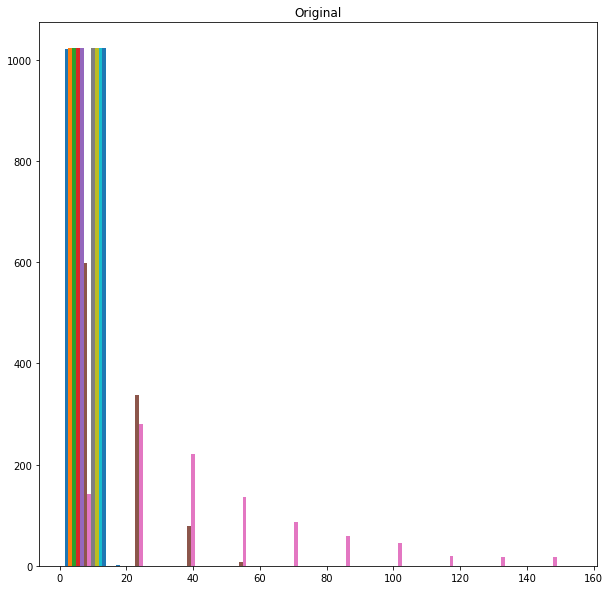

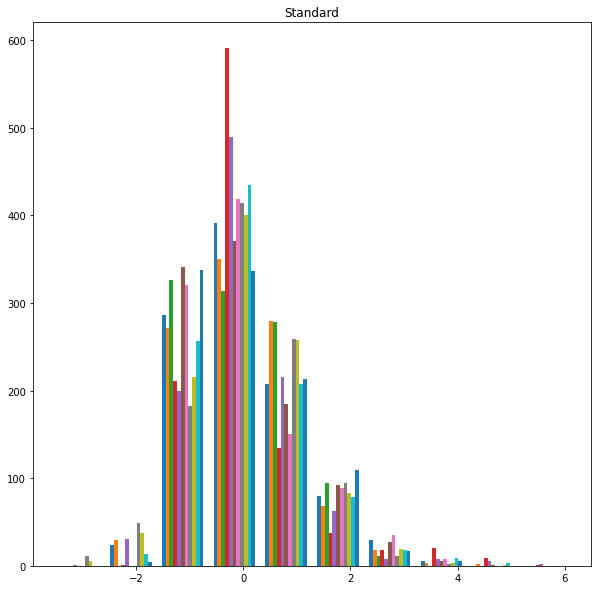

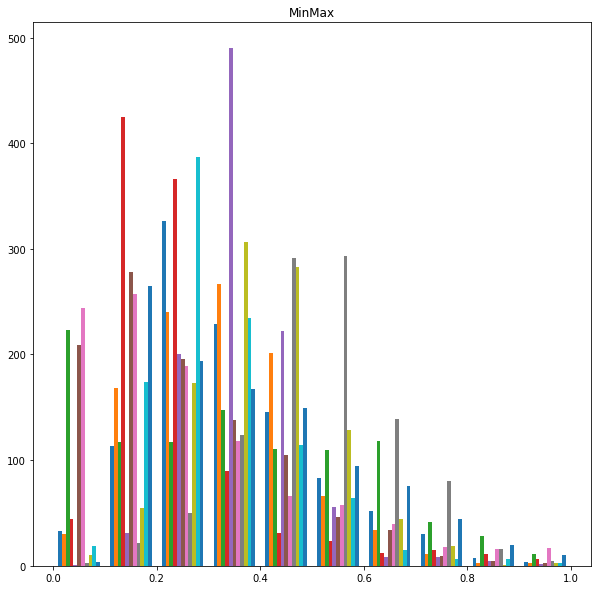

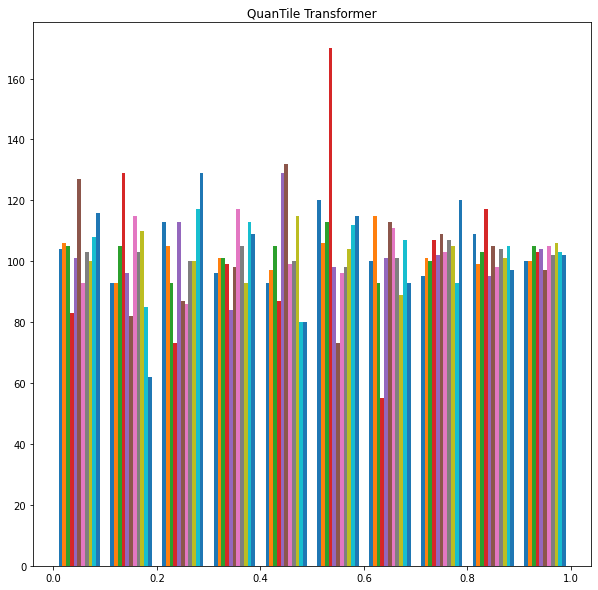

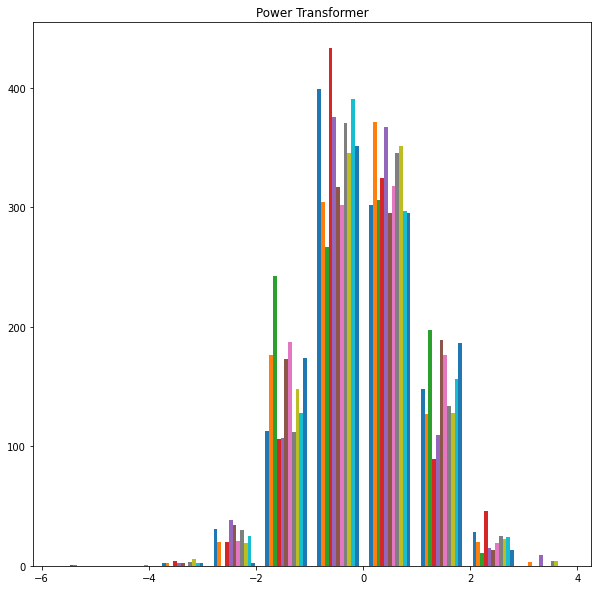

In [24]:
plt.figure(figsize=(10,10))
plt.hist(X_train[:])
plt.title('Original')
plt.show()

plt.figure(figsize=(10,10))
plt.hist(X_train_SS[:])
plt.title('Standard')
plt.show()

plt.figure(figsize=(10,10))
plt.hist(X_train_MM[:])
plt.title('MinMax')
plt.show()

plt.figure(figsize=(10,10))
plt.hist(X_train_QT[:])
plt.title('QuanTile Transformer')
plt.show()

plt.figure(figsize=(10,10))
plt.hist(X_train_PT[:])
plt.title('Power Transformer')
plt.show()

## Original Result

In [29]:
xgb_model = xgb.XGBRegressor(booster='gbtree',learning_rate=best_params['learning_rate'], subsample=0.75, colsample_bytree=1, max_depth=best_params['max_depths'], eval_metric='rmse', scale_pos_weight=6, objective='reg:squarederror', base_score=5.5, n_estimators=best_params['n_estimators'])
xgb_model.fit(X_train, y_train)

XGBRegressor(base_score=5.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eval_metric='rmse',
             gamma=0, gpu_id=-1, importance_type='gain',
             interaction_constraints='', learning_rate=0.005, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=6,
             num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
             scale_pos_weight=6, subsample=0.75, tree_method='exact',
             validate_parameters=1, verbosity=None)

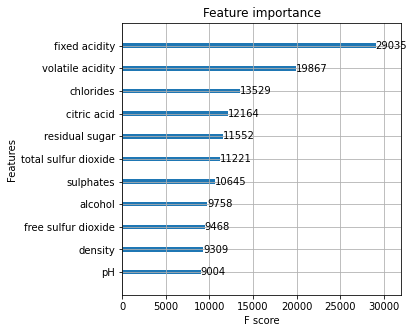

In [30]:
plt.rcParams['figure.figsize'] = [5, 5]
xgb.plot_importance(xgb_model)
plt.show()

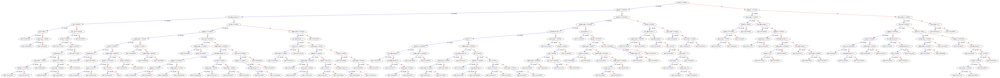

In [31]:
plt.rcParams['figure.figsize'] = [150, 400]
xgb.plot_tree(xgb_model,num_treesasd=0)
plt.show()

In [32]:
predictions = xgb_model.predict(X_test)
mse = np.sum((y_test - predictions)**2) / len(predictions)
rmse = np.sqrt(mse)
mae = np.sum(np.abs((y_test - predictions)/y_test))/len(predictions)
mape = mae * 100
print(mse, rmse, mae, mape)

0.3428412323422872 0.5855264574229649 0.07374263555809103 7.374263555809104


## Standard Scaler Result

In [33]:
xgb_model = xgb.XGBRegressor(booster='gbtree',learning_rate=best_params['learning_rate'], subsample=0.75, colsample_bytree=1, max_depth=best_params['max_depths'], eval_metric='rmse', scale_pos_weight=6, objective='reg:squarederror', base_score=5.5, n_estimators=best_params['n_estimators'])
xgb_model.fit(X_train_SS, y_train)

XGBRegressor(base_score=5.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eval_metric='rmse',
             gamma=0, gpu_id=-1, importance_type='gain',
             interaction_constraints='', learning_rate=0.005, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=6,
             num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
             scale_pos_weight=6, subsample=0.75, tree_method='exact',
             validate_parameters=1, verbosity=None)

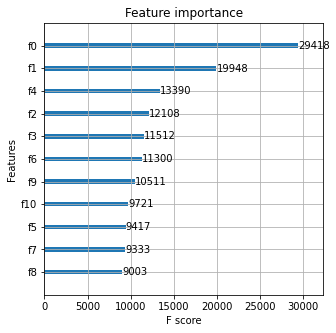

In [34]:
plt.rcParams['figure.figsize'] = [5, 5]
xgb.plot_importance(xgb_model)
plt.show()

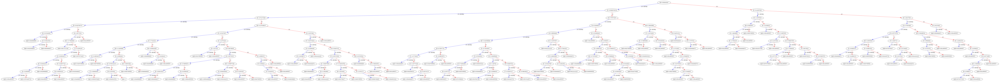

In [35]:
plt.rcParams['figure.figsize'] = [150, 400]
xgb.plot_tree(xgb_model,num_treesasd=0)
plt.show()

In [36]:
predictions = xgb_model.predict(X_test_SS)
mse = np.sum((y_test - predictions)**2) / len(predictions)
rmse = np.sqrt(mse)
mae = np.sum(np.abs((y_test - predictions)/y_test))/len(predictions)
mape = mae * 100
print(mse, rmse, mae, mape)

0.3419077363158202 0.5847287715820217 0.07360229406869395 7.360229406869395


## MinMax Scaler Result

In [37]:
xgb_model = xgb.XGBRegressor(booster='gbtree',learning_rate=best_params['learning_rate'], subsample=0.75, colsample_bytree=1, max_depth=best_params['max_depths'], eval_metric='rmse', scale_pos_weight=6, objective='reg:squarederror', base_score=5.5, n_estimators=best_params['n_estimators'])
xgb_model.fit(X_train_MM, y_train)

XGBRegressor(base_score=5.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eval_metric='rmse',
             gamma=0, gpu_id=-1, importance_type='gain',
             interaction_constraints='', learning_rate=0.005, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=6,
             num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
             scale_pos_weight=6, subsample=0.75, tree_method='exact',
             validate_parameters=1, verbosity=None)

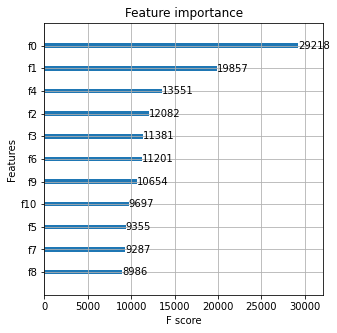

In [38]:
plt.rcParams['figure.figsize'] = [5, 5]
xgb.plot_importance(xgb_model)
plt.show()

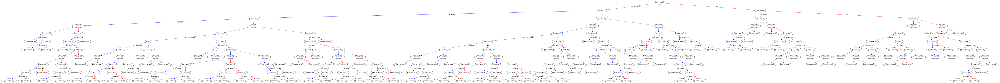

In [39]:
plt.rcParams['figure.figsize'] = [150, 400]
xgb.plot_tree(xgb_model,num_treesasd=0)
plt.show()

In [40]:
predictions = xgb_model.predict(X_test_MM)
mse = np.sum((y_test - predictions)**2) / len(predictions)
rmse = np.sqrt(mse)
mae = np.sum(np.abs((y_test - predictions)/y_test))/len(predictions)
mape = mae * 100
print(mse, rmse, mae, mape)

0.3420506111727561 0.5848509307274428 0.07351929028154487 7.351929028154487


## Qunatile Transform Result

In [41]:
xgb_model = xgb.XGBRegressor(booster='gbtree',learning_rate=best_params['learning_rate'], subsample=0.75, colsample_bytree=1, max_depth=best_params['max_depths'], eval_metric='rmse', scale_pos_weight=6, objective='reg:squarederror', base_score=5.5, n_estimators=best_params['n_estimators'])
xgb_model.fit(X_train_QT, y_train)

XGBRegressor(base_score=5.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eval_metric='rmse',
             gamma=0, gpu_id=-1, importance_type='gain',
             interaction_constraints='', learning_rate=0.005, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=6,
             num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
             scale_pos_weight=6, subsample=0.75, tree_method='exact',
             validate_parameters=1, verbosity=None)

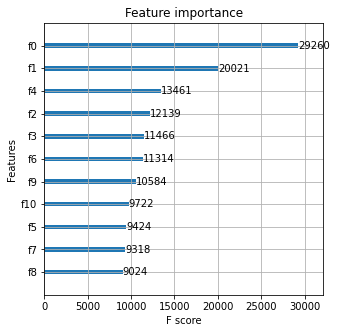

In [42]:
plt.rcParams['figure.figsize'] = [5, 5]
xgb.plot_importance(xgb_model)
plt.show()

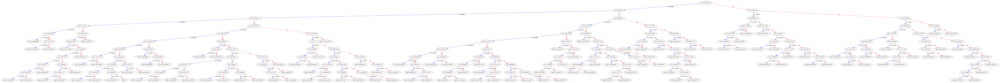

In [45]:
plt.rcParams['figure.figsize'] = [150, 400]
xgb.plot_tree(xgb_model,num_treesasd=0)
plt.show()

In [46]:
predictions = xgb_model.predict(X_test_QT)
mse = np.sum((y_test - predictions)**2) / len(predictions)
rmse = np.sqrt(mse)
mae = np.sum(np.abs((y_test - predictions)/y_test))/len(predictions)
mape = mae * 100
print(mse, rmse, mae, mape)

0.3435012081744038 0.586089761192263 0.07370750275831749 7.370750275831749


# Power Transform Result

In [47]:
xgb_model = xgb.XGBRegressor(booster='gbtree',learning_rate=best_params['learning_rate'], subsample=0.75, colsample_bytree=1, max_depth=best_params['max_depths'], eval_metric='rmse', scale_pos_weight=6, objective='reg:squarederror', base_score=5.5, n_estimators=best_params['n_estimators'])
xgb_model.fit(X_train_PT, y_train)

XGBRegressor(base_score=5.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eval_metric='rmse',
             gamma=0, gpu_id=-1, importance_type='gain',
             interaction_constraints='', learning_rate=0.005, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=6,
             num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
             scale_pos_weight=6, subsample=0.75, tree_method='exact',
             validate_parameters=1, verbosity=None)

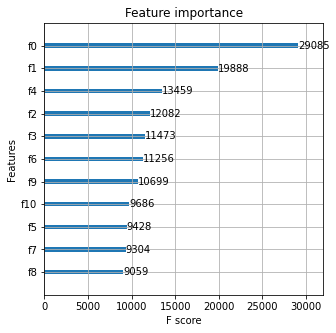

In [48]:
plt.rcParams['figure.figsize'] = [5, 5]
xgb.plot_importance(xgb_model)
plt.show()

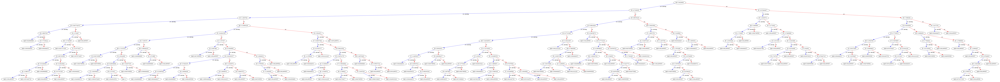

In [49]:
plt.rcParams['figure.figsize'] = [150, 400]
xgb.plot_tree(xgb_model,num_treesasd=0)
plt.show()

In [50]:
predictions = xgb_model.predict(X_test_PT)
mse = np.sum((y_test - predictions)**2) / len(predictions)
rmse = np.sqrt(mse)
mae = np.sum(np.abs((y_test - predictions)/y_test))/len(predictions)
mape = mae * 100
print(mse, rmse, mae, mape)

0.3430814423424086 0.5857315446024813 0.07374005540819002 7.374005540819002


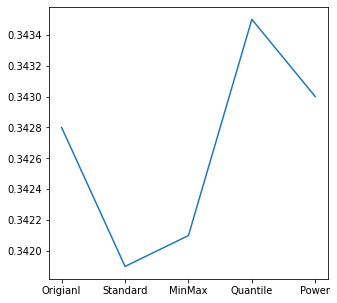

In [52]:
mse_scores = {'Origianl':0.3428, 'Standard':0.3419, 'MinMax':0.3421, 'Quantile':0.3435, 'Power':0.3430}
x, y = zip(*mse_scores.items())
plt.rcParams["figure.figsize"] = [5, 5]
plt.plot(x,y)
plt.show()

Preprocessing Result  

Best XGBoost MSE : 0.3464  
Best Preprocessing : Standard Scaling  
Best XGBoost Parameters : LearningRate 0.005, MaxDepth 10, n_estimators 1000

# 3. Over Sampling Experiment

In [57]:
X_train_ROS, y_train_ROS = RandomOverSampler(random_state=96).fit_resample(X_train, y_train)

In [58]:
X_train_SMOTE, y_train_SMOTE = SMOTE(random_state=96).fit_resample(X_train, y_train)

In [59]:
X_train_BSMOTE, y_train_BSMOTE = BorderlineSMOTE(random_state=96).fit_resample(X_train, y_train)

In [60]:
X_train_SSMOTE, y_train_SSMOTE = SVMSMOTE(random_state=96).fit_resample(X_train, y_train)

Text(0.5, 1.0, 'SVM SMOTE')

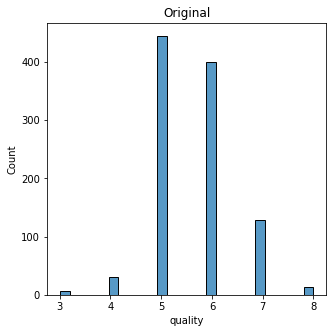

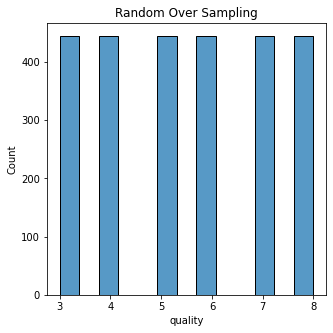

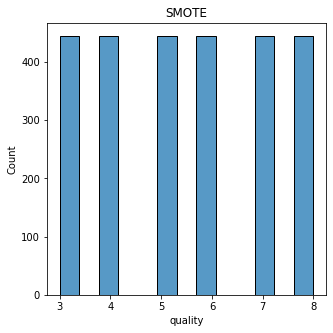

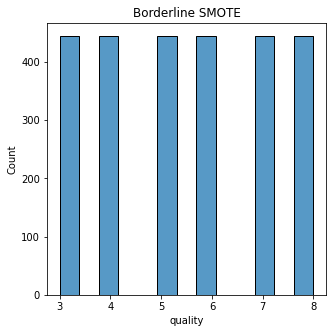

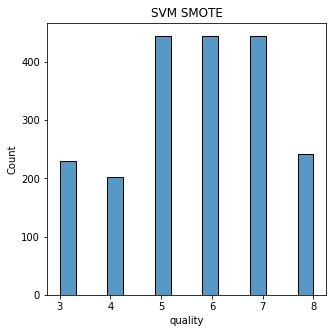

In [62]:
plt.figure(figsize=(5,5))
sns.histplot(data=y_train)
plt.title('Original')

plt.figure(figsize=(5,5))
sns.histplot(data=y_train_ROS)
plt.title('Random Over Sampling')

plt.figure(figsize=(5,5))
sns.histplot(data=y_train_SMOTE)
plt.title('SMOTE')

plt.figure(figsize=(5,5))
sns.histplot(data=y_train_BSMOTE)
plt.title('Borderline SMOTE')

plt.figure(figsize=(5,5))
sns.histplot(data=y_train_SSMOTE)
plt.title('SVM SMOTE')

## Random Oversamplig Result

In [63]:
xgb_model = xgb.XGBRegressor(booster='gbtree',learning_rate=best_params['learning_rate'], subsample=0.75, colsample_bytree=1, max_depth=best_params['max_depths'], eval_metric='rmse', scale_pos_weight=6, objective='reg:squarederror', base_score=5.5, n_estimators=best_params['n_estimators'])
xgb_model.fit(X_train_ROS, y_train_ROS)

XGBRegressor(base_score=5.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eval_metric='rmse',
             gamma=0, gpu_id=-1, importance_type='gain',
             interaction_constraints='', learning_rate=0.005, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=6,
             num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
             scale_pos_weight=6, subsample=0.75, tree_method='exact',
             validate_parameters=1, verbosity=None)

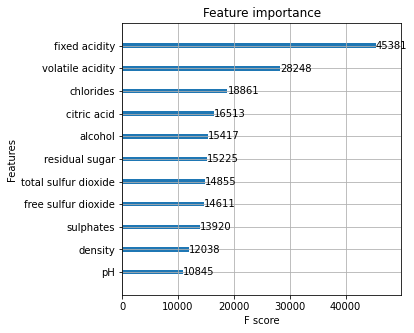

In [64]:
plt.rcParams['figure.figsize'] = [5, 5]
xgb.plot_importance(xgb_model)
plt.show()

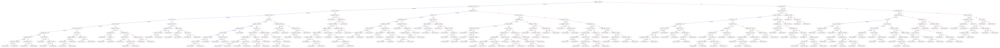

In [65]:
plt.rcParams['figure.figsize'] = [150, 400]
xgb.plot_tree(xgb_model,num_treesasd=0)
plt.show()

In [66]:
predictions = xgb_model.predict(X_test)
mse = np.sum((y_test - predictions)**2) / len(predictions)
rmse = np.sqrt(mse)
mae = np.sum(np.abs((y_test - predictions)/y_test))/len(predictions)
mape = mae * 100
print(mse, rmse, mae, mape)

0.3809715839231423 0.6172289558366022 0.07786430621135915 7.786430621135914


## SMOTE Result

In [67]:
xgb_model = xgb.XGBRegressor(booster='gbtree',learning_rate=best_params['learning_rate'], subsample=0.75, colsample_bytree=1, max_depth=best_params['max_depths'], eval_metric='rmse', scale_pos_weight=6, objective='reg:squarederror', base_score=5.5, n_estimators=best_params['n_estimators'])
xgb_model.fit(X_train_SMOTE, y_train_SMOTE)

XGBRegressor(base_score=5.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eval_metric='rmse',
             gamma=0, gpu_id=-1, importance_type='gain',
             interaction_constraints='', learning_rate=0.005, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=6,
             num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
             scale_pos_weight=6, subsample=0.75, tree_method='exact',
             validate_parameters=1, verbosity=None)

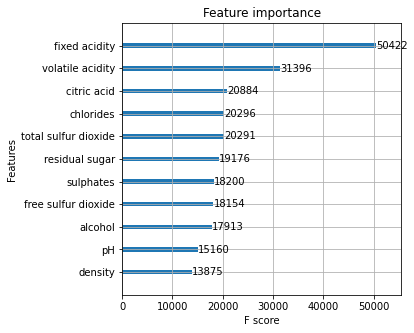

In [68]:
plt.rcParams['figure.figsize'] = [5, 5]
xgb.plot_importance(xgb_model)
plt.show()

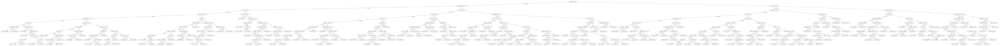

In [69]:
plt.rcParams['figure.figsize'] = [150, 400]
xgb.plot_tree(xgb_model,num_treesasd=0)
plt.show()

In [70]:
predictions = xgb_model.predict(X_test)
mse = np.sum((y_test - predictions)**2) / len(predictions)
rmse = np.sqrt(mse)
mae = np.sum(np.abs((y_test - predictions)/y_test))/len(predictions)
mape = mae * 100
print(mse, rmse, mae, mape)

0.4207813277150363 0.6486765971692183 0.0817728280099368 8.17728280099368


## Borederline SMOTE

In [71]:
xgb_model = xgb.XGBRegressor(booster='gbtree',learning_rate=best_params['learning_rate'], subsample=0.75, colsample_bytree=1, max_depth=best_params['max_depths'], eval_metric='rmse', scale_pos_weight=6, objective='reg:squarederror', base_score=5.5, n_estimators=best_params['n_estimators'])
xgb_model.fit(X_train_BSMOTE, y_train_BSMOTE)

XGBRegressor(base_score=5.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eval_metric='rmse',
             gamma=0, gpu_id=-1, importance_type='gain',
             interaction_constraints='', learning_rate=0.005, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=6,
             num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
             scale_pos_weight=6, subsample=0.75, tree_method='exact',
             validate_parameters=1, verbosity=None)

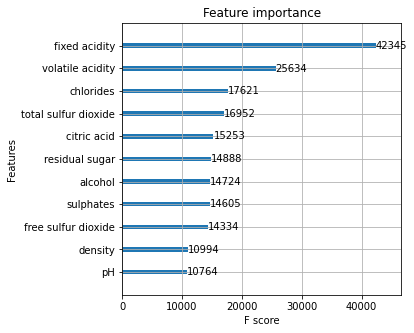

In [72]:
plt.rcParams['figure.figsize'] = [5, 5]
xgb.plot_importance(xgb_model)
plt.show()

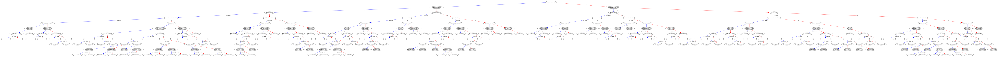

In [73]:
plt.rcParams['figure.figsize'] = [150, 400]
xgb.plot_tree(xgb_model,num_treesasd=0)
plt.show()

In [74]:
predictions = xgb_model.predict(X_test)
mse = np.sum((y_test - predictions)**2) / len(predictions)
rmse = np.sqrt(mse)
mae = np.sum(np.abs((y_test - predictions)/y_test))/len(predictions)
mape = mae * 100
print(mse, rmse, mae, mape)

0.3530943984859849 0.5942174673349689 0.07749150551472672 7.749150551472672


## SVM SMOTE

In [75]:
xgb_model = xgb.XGBRegressor(booster='gbtree',learning_rate=best_params['learning_rate'], subsample=0.75, colsample_bytree=1, max_depth=best_params['max_depths'], eval_metric='rmse', scale_pos_weight=6, objective='reg:squarederror', base_score=5.5, n_estimators=best_params['n_estimators'])
xgb_model.fit(X_train_SSMOTE, y_train_SSMOTE)

XGBRegressor(base_score=5.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eval_metric='rmse',
             gamma=0, gpu_id=-1, importance_type='gain',
             interaction_constraints='', learning_rate=0.005, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=6,
             num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
             scale_pos_weight=6, subsample=0.75, tree_method='exact',
             validate_parameters=1, verbosity=None)

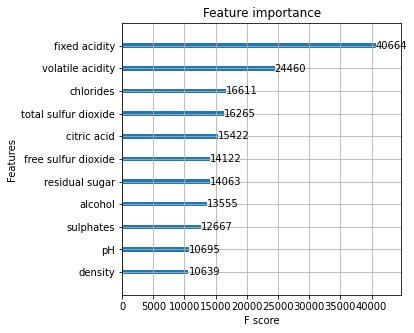

In [76]:
plt.rcParams['figure.figsize'] = [5, 5]
xgb.plot_importance(xgb_model)
plt.show()

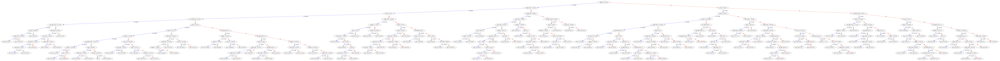

In [77]:
plt.rcParams['figure.figsize'] = [150, 400]
xgb.plot_tree(xgb_model,num_treesasd=0)
plt.show()

In [78]:
predictions = xgb_model.predict(X_test)
mse = np.sum((y_test - predictions)**2) / len(predictions)
rmse = np.sqrt(mse)
mae = np.sum(np.abs((y_test - predictions)/y_test))/len(predictions)
mape = mae * 100
print(mse, rmse, mae, mape)

0.35117246169774047 0.5925980608285354 0.07606314413393515 7.606314413393515


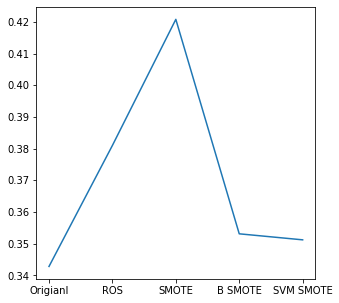

In [80]:
mse_scores = {'Origianl':0.3428, 'ROS':0.3810, 'SMOTE':0.4208, 'B SMOTE':0.3531, 'SVM SMOTE':0.3512}
x, y = zip(*mse_scores.items())
plt.rcParams["figure.figsize"] = [5, 5]
plt.plot(x,y)
plt.show()

In [81]:
ss_scaler = StandardScaler()
X_train_SS = ss_scaler.fit_transform(X_train_SSMOTE)
X_test_SS = ss_scaler.transform(X_test)

In [83]:
xgb_model = xgb.XGBRegressor(booster='gbtree',learning_rate=best_params['learning_rate'], subsample=0.75, colsample_bytree=1, max_depth=best_params['max_depths'], eval_metric='rmse', scale_pos_weight=6, objective='reg:squarederror', base_score=5.5, n_estimators=best_params['n_estimators'])
xgb_model.fit(X_train_SS, y_train_SSMOTE)

XGBRegressor(base_score=5.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, eval_metric='rmse',
             gamma=0, gpu_id=-1, importance_type='gain',
             interaction_constraints='', learning_rate=0.005, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=6,
             num_parallel_tree=1, random_state=0, reg_alpha=0, reg_lambda=1,
             scale_pos_weight=6, subsample=0.75, tree_method='exact',
             validate_parameters=1, verbosity=None)

In [85]:
predictions = xgb_model.predict(X_test_SS)
mse = np.sum((y_test - predictions)**2) / len(predictions)
rmse = np.sqrt(mse)
mae = np.sum(np.abs((y_test - predictions)/y_test))/len(predictions)
mape = mae * 100
print(mse, rmse, mae, mape)

0.3502494102331963 0.5918187308907993 0.07597932099733978 7.5979320997339785


OverSampling Result

Best MSE : Original  
OverSampling useless

XGBoost Regressor Result  

Original + Standard Scaling  
MSE : 0.3464  